# Sieć służąca do klasyfikacji pastylek leków - analiza filtrów
Wykonał Bartłomiej Tarcholik

In [2]:
import json
import numpy as np
import tensorflow as tf
import random
from keras import layers
from keras import models
from keras.models import load_model
from matplotlib import pyplot as plt
from tensorflow.keras import backend as K
tf.compat.v1.disable_eager_execution()

resultList = []
for i in range(5):
  model = load_model('C:/ml/models/pills_final_ranking/' + str(i + 1) + '.h5')
  with open('C:/ml/models/pills_final_ranking/' + str(i + 1) + '.json') as user_file:
    file_contents = user_file.read()
  data = json.loads(file_contents)
  resultList.append([
    model,
    data[0],
    data[1],
    data[2],
    data[3],
    data[4],
    data[5]
  ])

In [6]:
def deprocess_image(x):
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1
    x += 0.5
    x = np.clip(x, 0, 1)
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

def generate_pattern(m, layer_name, filter_index, size=64):
    layer_output = m.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])
    grads = K.gradients(loss, m.input)[0]
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)
    iterate = K.function([m.input], [loss, grads])
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step       
    img = input_img_data[0]
    return deprocess_image(img)

Dla każdego modelu biorę jego warstwy konwolucyjne i robię z nich listę dla wywołania kodu do wizualizacji filtrów.

In [4]:
size = 64
margin = 3
no = 8

for entry in resultList:
    layer_names = []
    for layer in entry[0].layers[:8]:
        if "conv2d" in layer.name:
            layer_names.append(layer.name)
    entry.append(layer_names)
    print(entry[7])

['conv2d_305', 'conv2d_306', 'conv2d_307', 'conv2d_308']
['conv2d_373', 'conv2d_374', 'conv2d_375', 'conv2d_376']
['conv2d', 'conv2d_1', 'conv2d_2', 'conv2d_3']
['conv2d_20', 'conv2d_21', 'conv2d_22', 'conv2d_23']
['conv2d_10', 'conv2d_11', 'conv2d_12', 'conv2d_13']


### Sieć pierwsza (1 warstwa Conv2d z 32 neuronami oraz 4 warstwy po 64 neurony, 256 neuronów gęstych, funkcja aktywacji ReLU oraz optymalizator Adam)
Posiada olbrzymią liczbę kompletnie martwych filtrów znajdujących jedynie szum. Filtry, które czegoś szukają nie wyglądają na takie, które znajdują kształty dobrze odpowiadające szukaniu tabletek, często znajdują się na krawędziach. Niemniej jednak funkcjonujące filtry przypominają takie, które szukają "pochyłości" linii w celu określenia kształtów.

1. Val_acc: 97.6: L:32-64-64-64-64- dns:256 relu adam
Layer name: conv2d_306


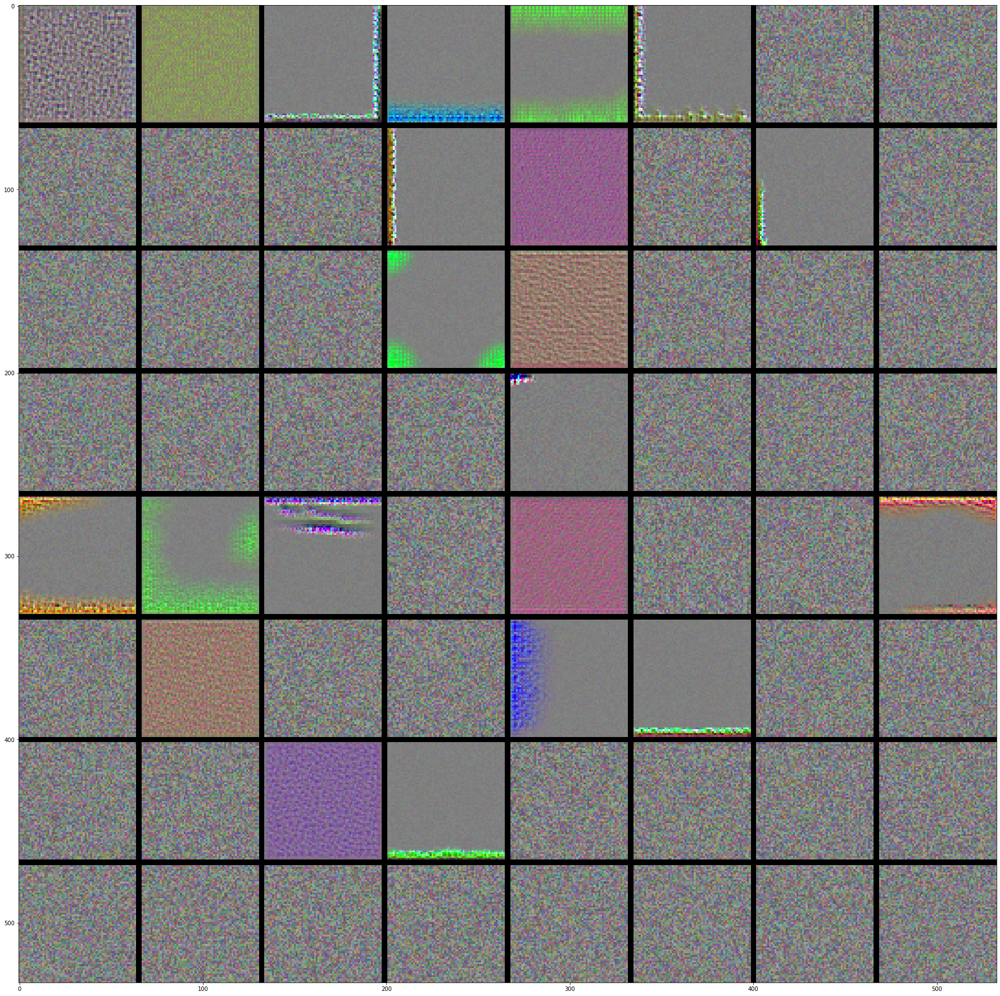

Layer name: conv2d_307


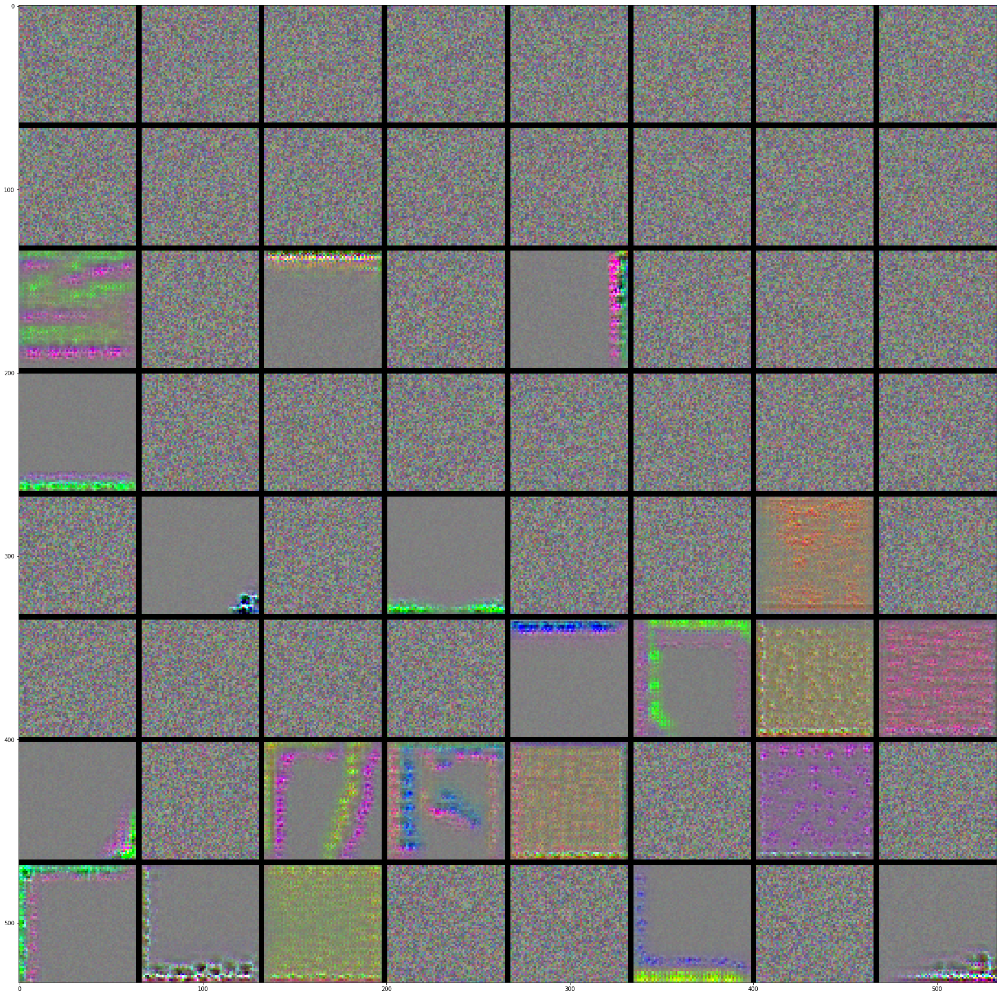

Layer name: conv2d_308


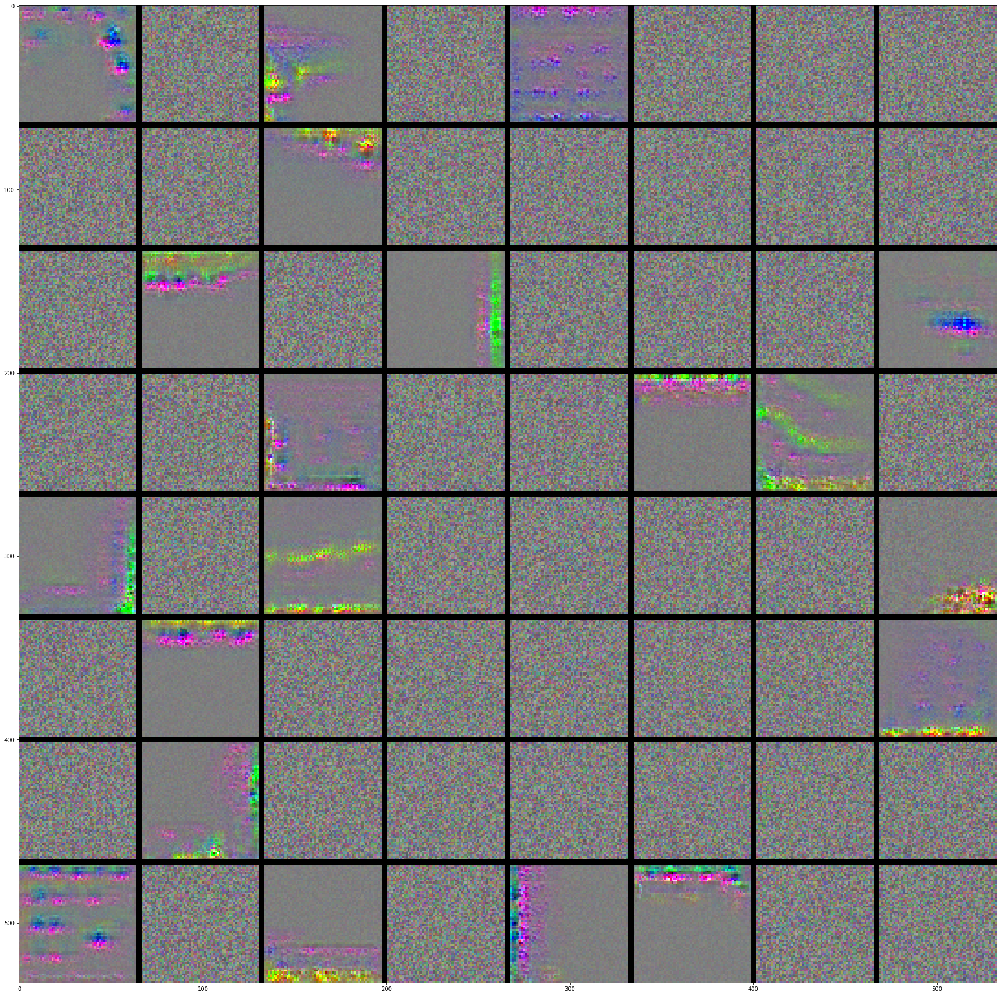

In [12]:
modelPlace = 0
print(str(modelPlace + 1) + ". Val_acc: " + str(round(resultList[modelPlace][2]['val_acc'][-1] * 100, 2)) + ": " + resultList[modelPlace][1])
for layer_name in resultList[modelPlace][7][1:]:
    results = np.zeros((no * size + 7 * margin, no * size + 7 * margin, 3), dtype=np.uint8)

    for i in range(no):
        for j in range(no):
            filter_img = generate_pattern(resultList[modelPlace][0], layer_name, i + (j * no), size=size)
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start : horizontal_end, vertical_start : vertical_end, : ] = filter_img
    print("Layer name: " + layer_name)
    plt.figure(figsize=(size / 2, size / 2))
    plt.imshow(results)
    plt.show()

### Sieć druga (1 warstwa Conv2d z 32 neuronami, 1 z 64 neuronami oraz 3 warstwy po 128 neuronów, 128 neuronów gęstych, funkcja aktywacji ReLU oraz optymalizator Adam)
Działa podobnie do pierwszej, lecz filtry tutaj działają w jeszcze bardziej chaotyczny sposób. Pojawiają się jednak filtry szukające bardziej tekstur i wzorów, aniżeli tylko linii.

2. Val_acc: 97.6: L:32-64-128-128-128- dns:128 relu adam
Layer name: conv2d_374


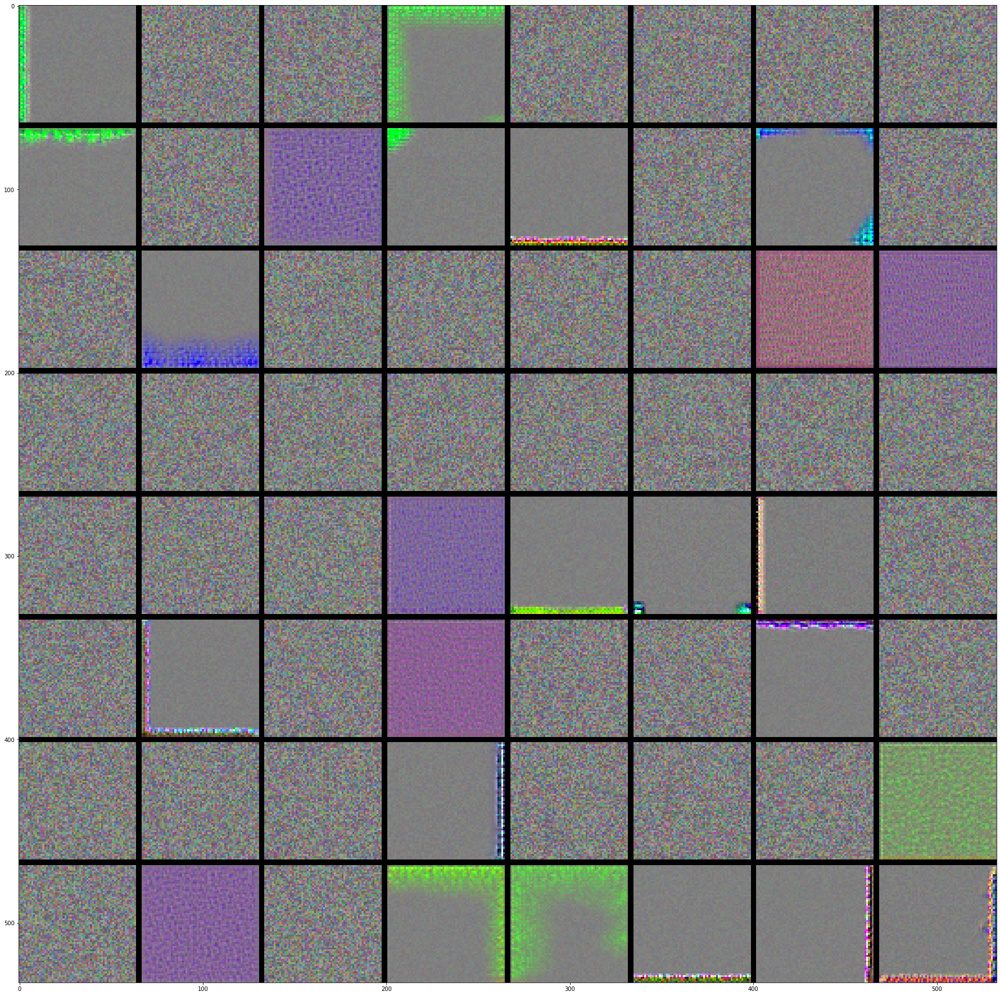

Layer name: conv2d_375


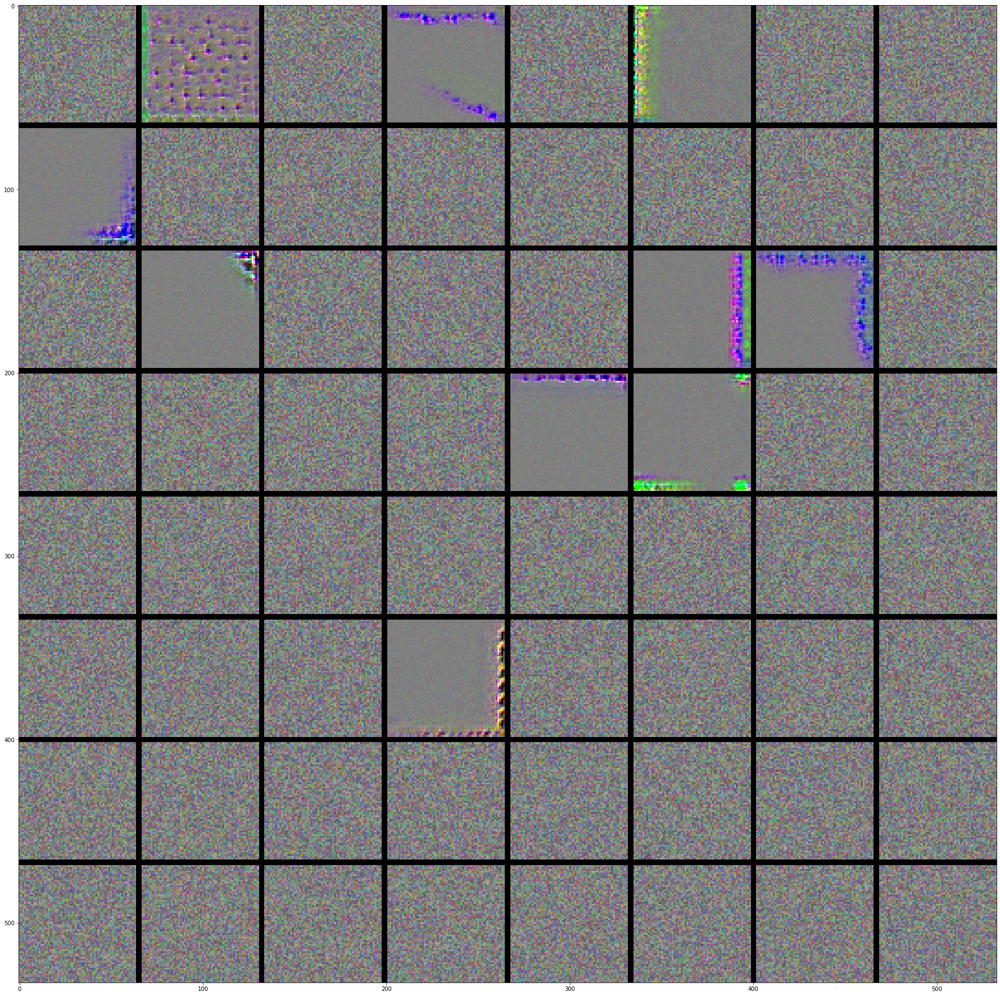

Layer name: conv2d_376


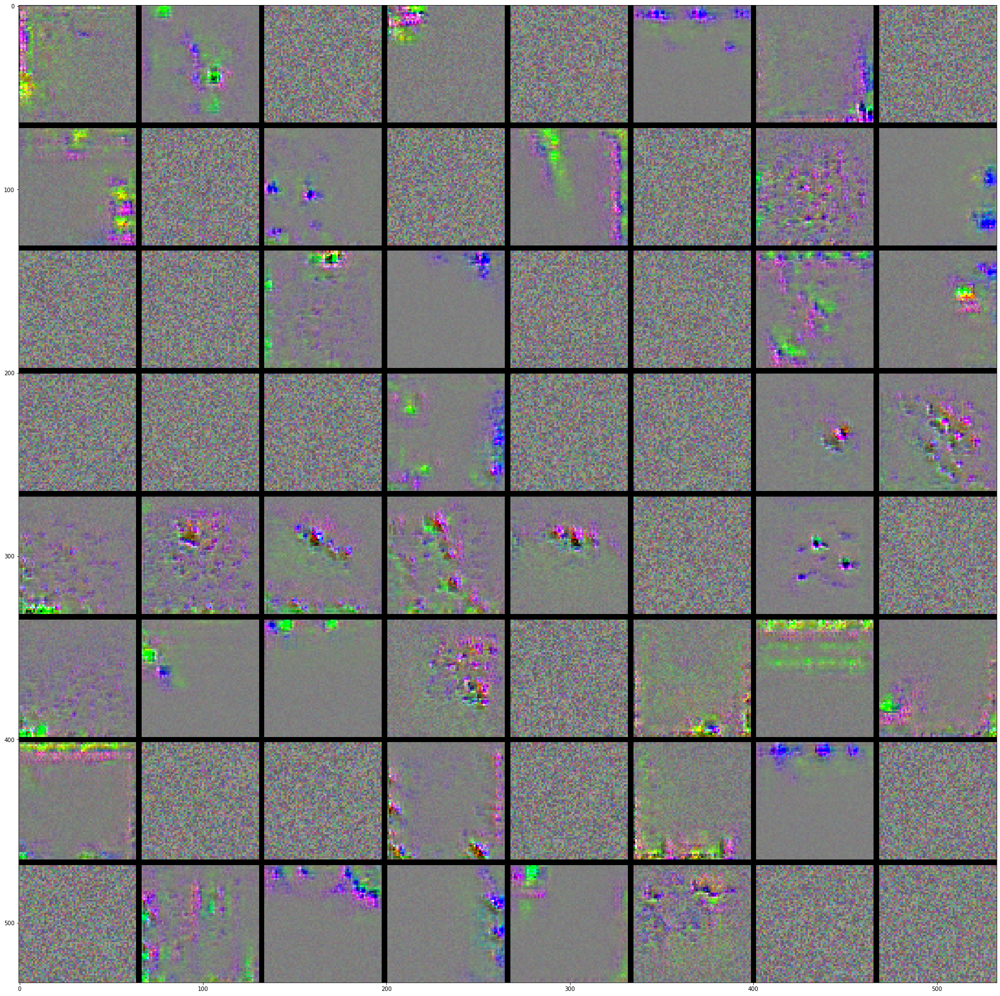

In [13]:
modelPlace = 1
print(str(modelPlace + 1) + ". Val_acc: " + str(round(resultList[modelPlace][2]['val_acc'][-1] * 100, 2)) + ": " + resultList[modelPlace][1])
for layer_name in resultList[modelPlace][7][1:]:
    results = np.zeros((no * size + 7 * margin, no * size + 7 * margin, 3), dtype=np.uint8)

    for i in range(no):
        for j in range(no):
            filter_img = generate_pattern(resultList[modelPlace][0], layer_name, i + (j * no), size=size)
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start : horizontal_end, vertical_start : vertical_end, : ] = filter_img
    print("Layer name: " + layer_name)
    plt.figure(figsize=(size / 2, size / 2))
    plt.imshow(results)
    plt.show()

### Sieć trzecia (1 warstwa Conv2d z 32 neuronami, 1 z 64 neuronami oraz 3 warstwy po 128 neuronów, 128 neuronów gęstych, funkcja aktywacji ReLU oraz optymalizator Adam, trenowana przez 70 epok)
Sprawuje się bardzo podobnie do drugiej, ale jeszcze mniej filtrów niestety "ma sens".

3. Val_acc: 97.3: L:32-64-128-128-128- dns:128 relu adam trained for 70 epochs
Layer name: conv2d_1


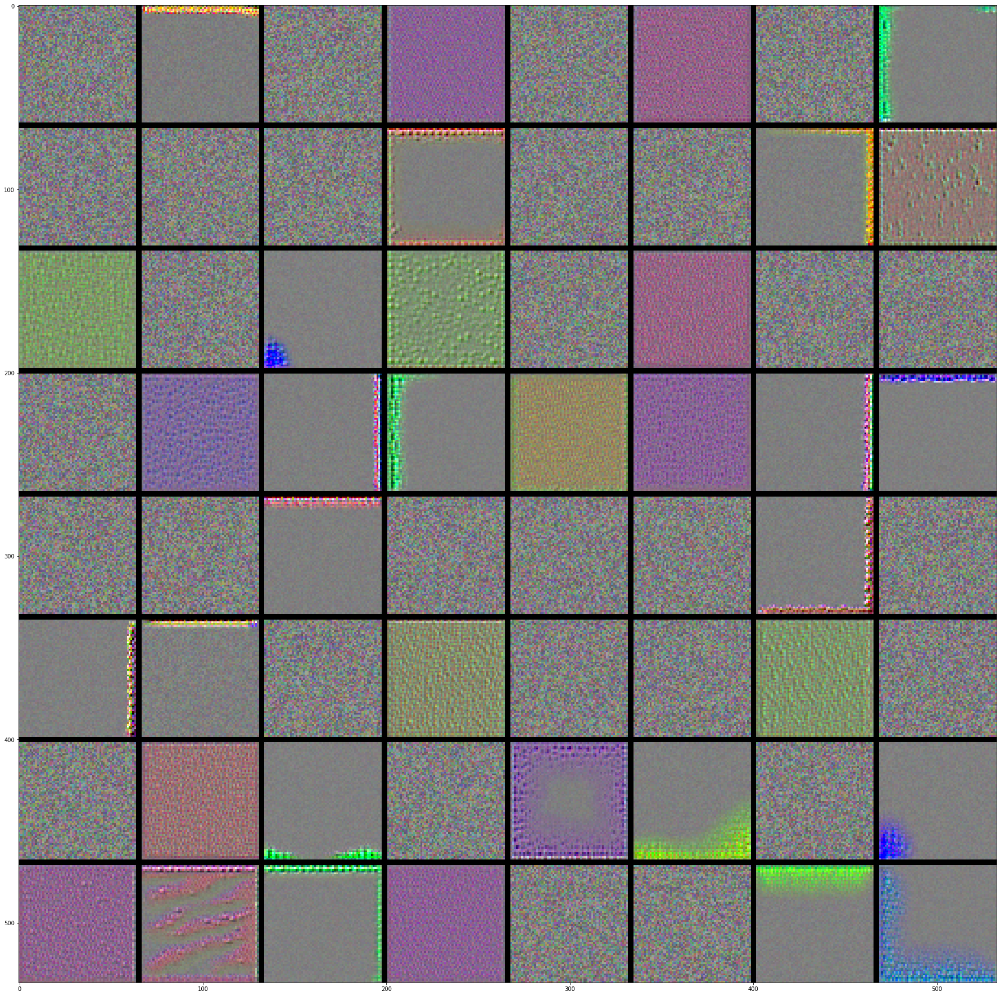

Layer name: conv2d_2


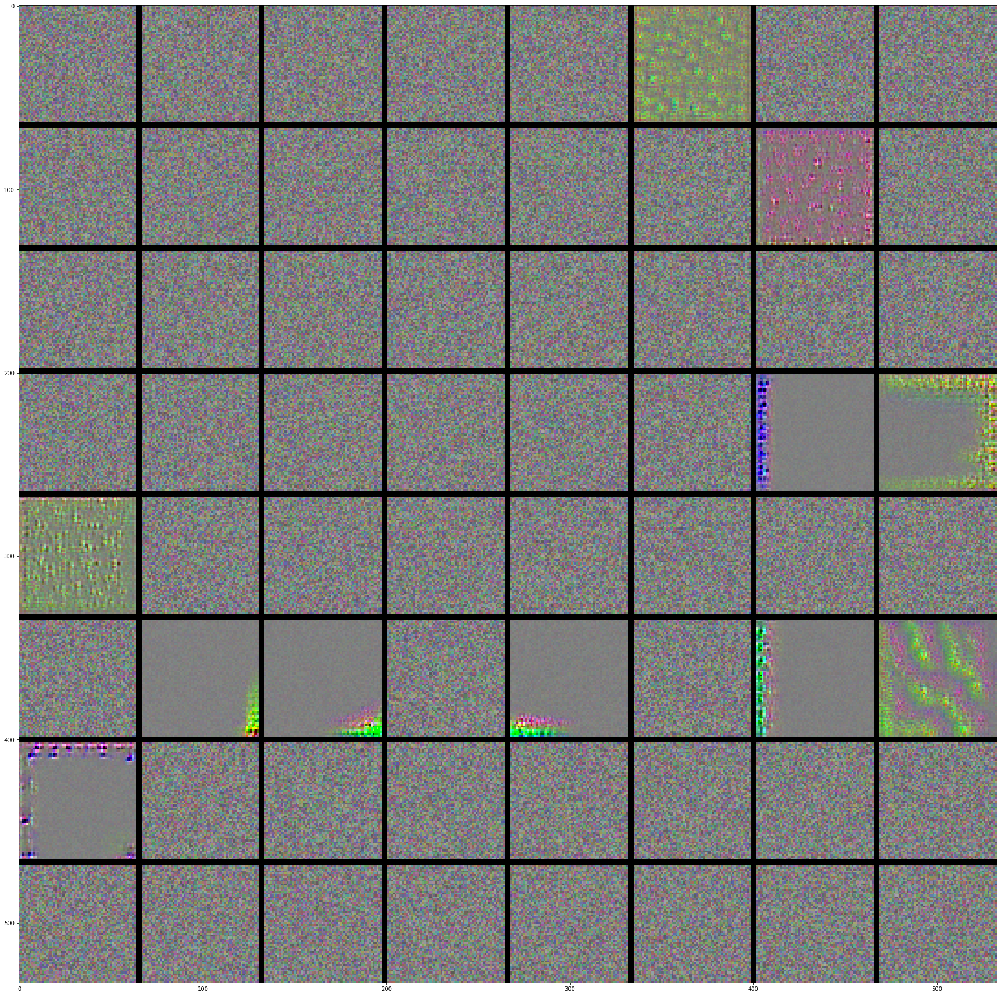

Layer name: conv2d_3


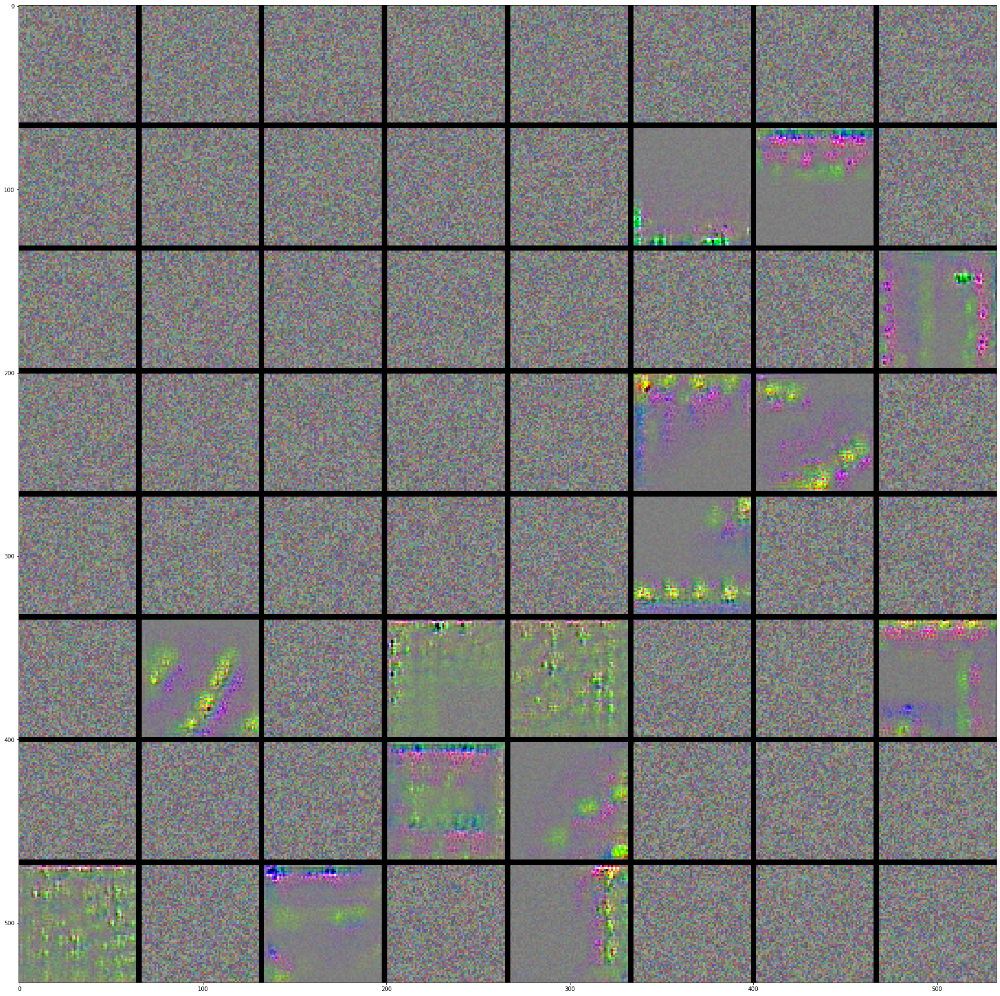

In [14]:
modelPlace = 2
print(str(modelPlace + 1) + ". Val_acc: " + str(round(resultList[modelPlace][2]['val_acc'][-1] * 100, 2)) + ": " + resultList[modelPlace][1])
for layer_name in resultList[modelPlace][7][1:]:
    results = np.zeros((no * size + 7 * margin, no * size + 7 * margin, 3), dtype=np.uint8)

    for i in range(no):
        for j in range(no):
            filter_img = generate_pattern(resultList[modelPlace][0], layer_name, i + (j * no), size=size)
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start : horizontal_end, vertical_start : vertical_end, : ] = filter_img
    print("Layer name: " + layer_name)
    plt.figure(figsize=(size / 2, size / 2))
    plt.imshow(results)
    plt.show()

### Sieć czwarta (1 warstwa Conv2d z 32 neuronami, 1 z 64 neuronami, 1 z 128 neuronami oraz 2 warstwy po 256 neuronów, 256 neuronów gęstych, funkcja aktywacji Leaky ReLU oraz optymalizator RMSProp, trenowana przez 96 epok)
Jest to sieć, gdzie występuje sporo filtór znajdujących szum, ale też i dużo więcej filtrów ewidentnie szukających czegoś konkretnego, niż w innych sieciach. Niestety sporo z nich szuka bardzo podobnych cech. Dzięki funkcji Leaky ReLU nie doszło do wygasania połączeń i mimo, ze sieć nie posiada filtrów szukających konkretnych wzorów jak w przypadku datasetu cats vs dogs, wygląda mi ona na najlepszy model jak na chwilę obecną.

4. Val_acc: 97.1: L:32-64-128-256-256- dns:256 leaky_relu rmsprop trained for 96 epochs
Layer name: conv2d_21


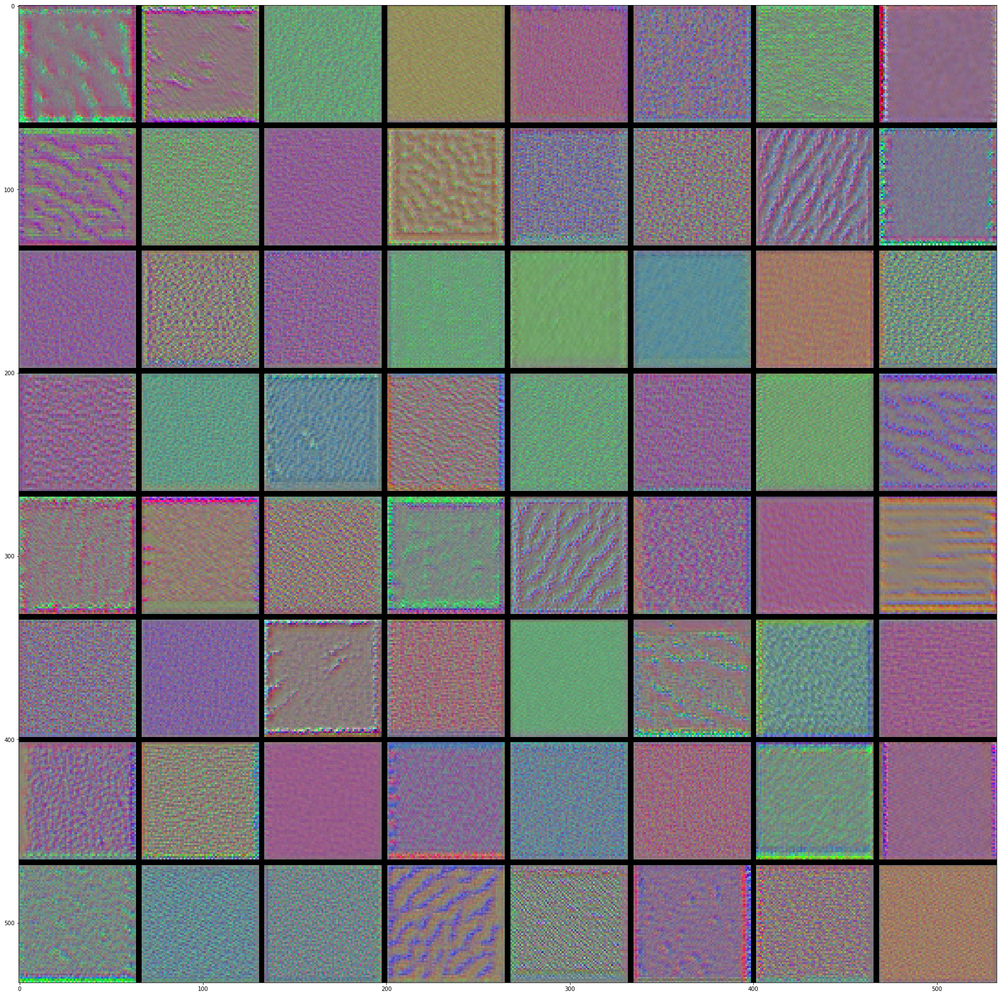

Layer name: conv2d_22


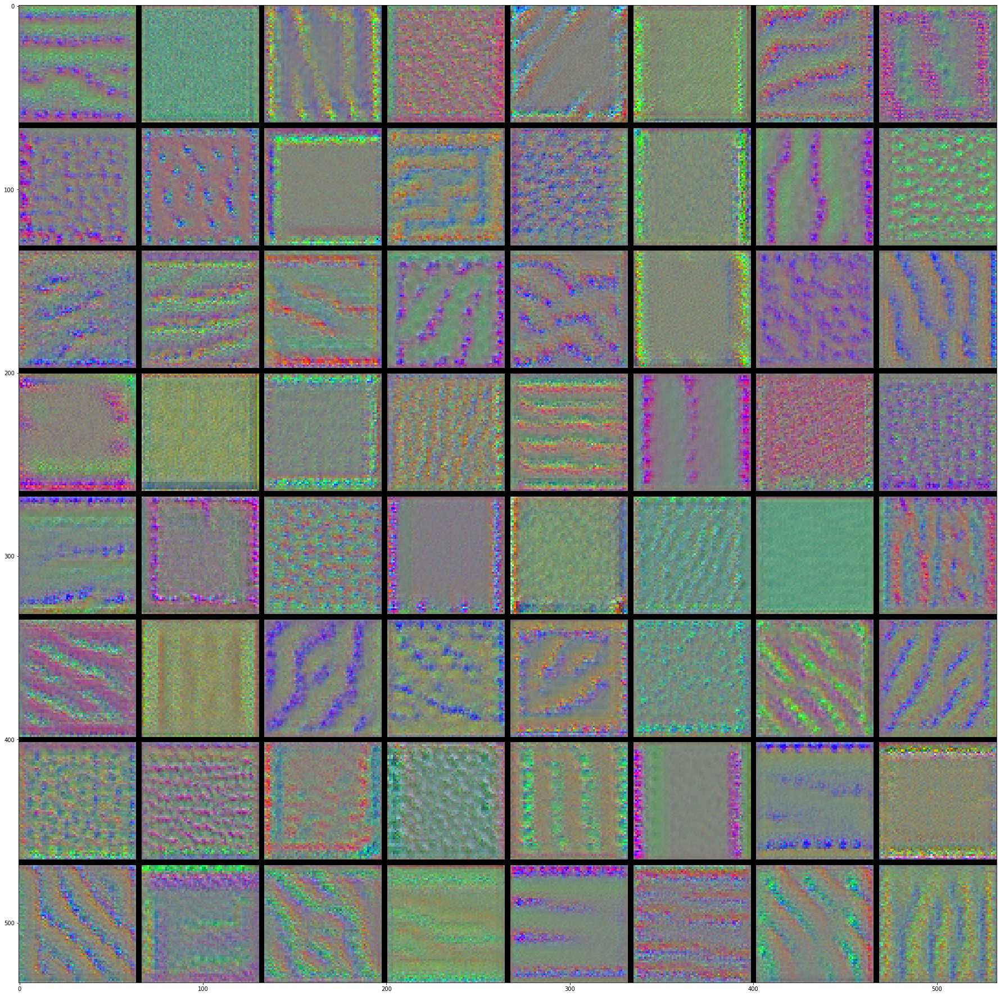

Layer name: conv2d_23


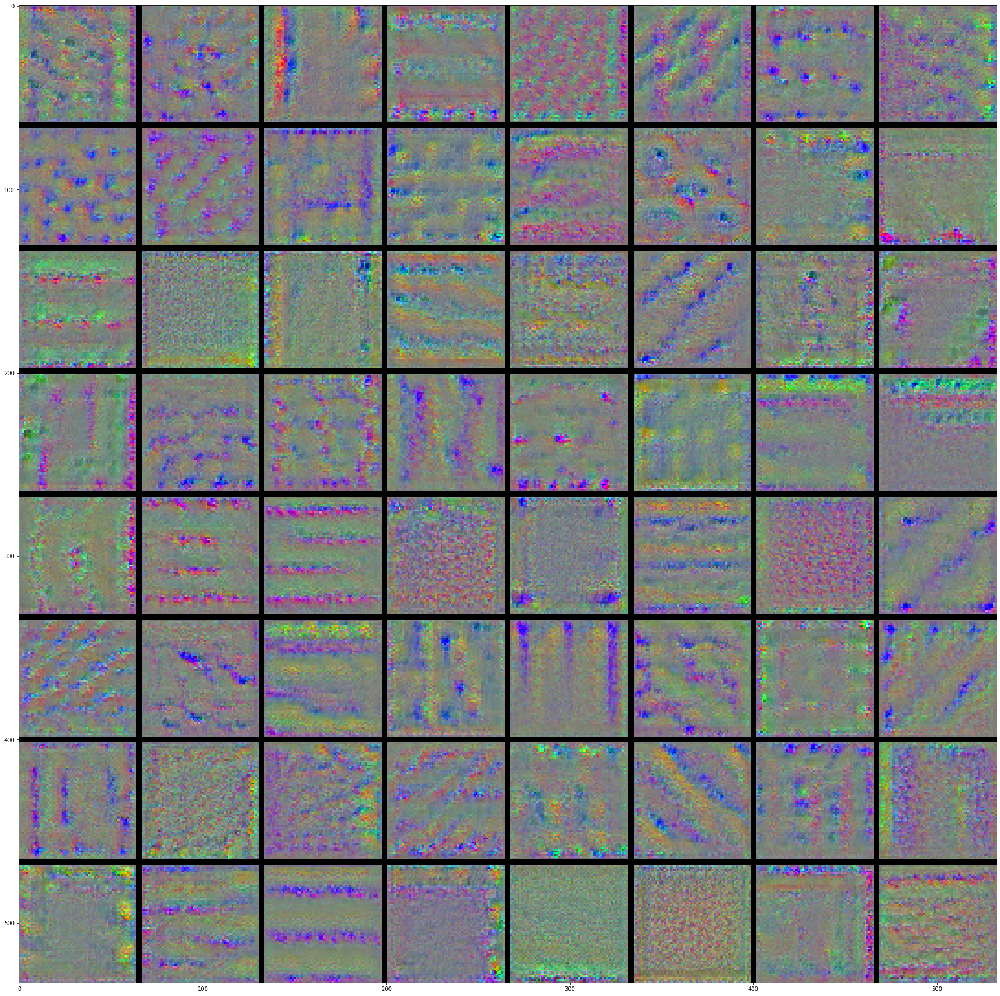

In [15]:
modelPlace = 3
print(str(modelPlace + 1) + ". Val_acc: " + str(round(resultList[modelPlace][2]['val_acc'][-1] * 100, 2)) + ": " + resultList[modelPlace][1])
for layer_name in resultList[modelPlace][7][1:]:
    results = np.zeros((no * size + 7 * margin, no * size + 7 * margin, 3), dtype=np.uint8)

    for i in range(no):
        for j in range(no):
            filter_img = generate_pattern(resultList[modelPlace][0], layer_name, i + (j * no), size=size)
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start : horizontal_end, vertical_start : vertical_end, : ] = filter_img
    print("Layer name: " + layer_name)
    plt.figure(figsize=(size / 2, size / 2))
    plt.imshow(results)
    plt.show()

### Sieć piąta (1 warstwa Conv2d z 32 neuronami, 1 z 64 neuronami oraz 3 warstwy po 128 neuronów, 64 neuronów gęstych, funkcja aktywacji ReLU oraz optymalizator Adam, trenowana przez 85 epok)
Niestety cierpi z bardzo podobnych problemów co sieci na miejscach 1-3. Wiele filtrów przedstawiających jedynie szum.

5. Val_acc: 97.1: L:32-64-128-128-128- dns:64 relu adam trained for 85 epochs
Layer name: conv2d_11


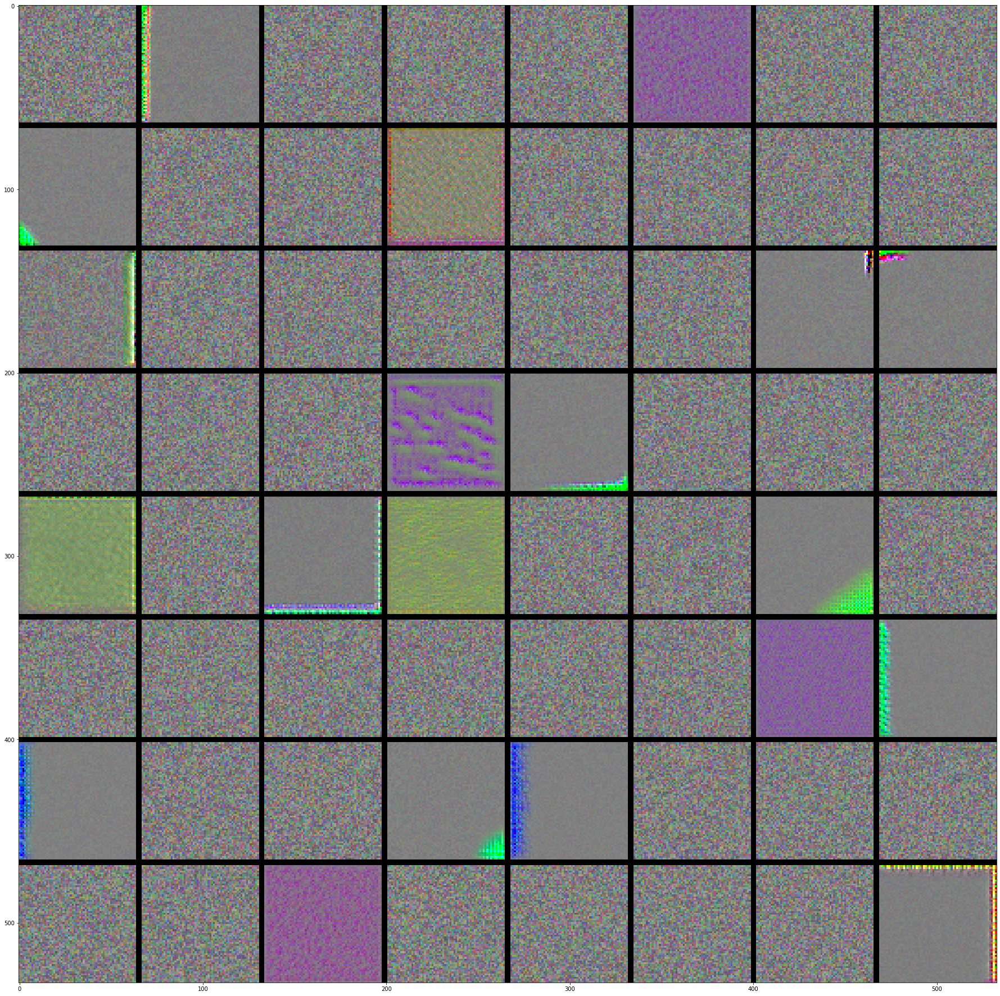

Layer name: conv2d_12


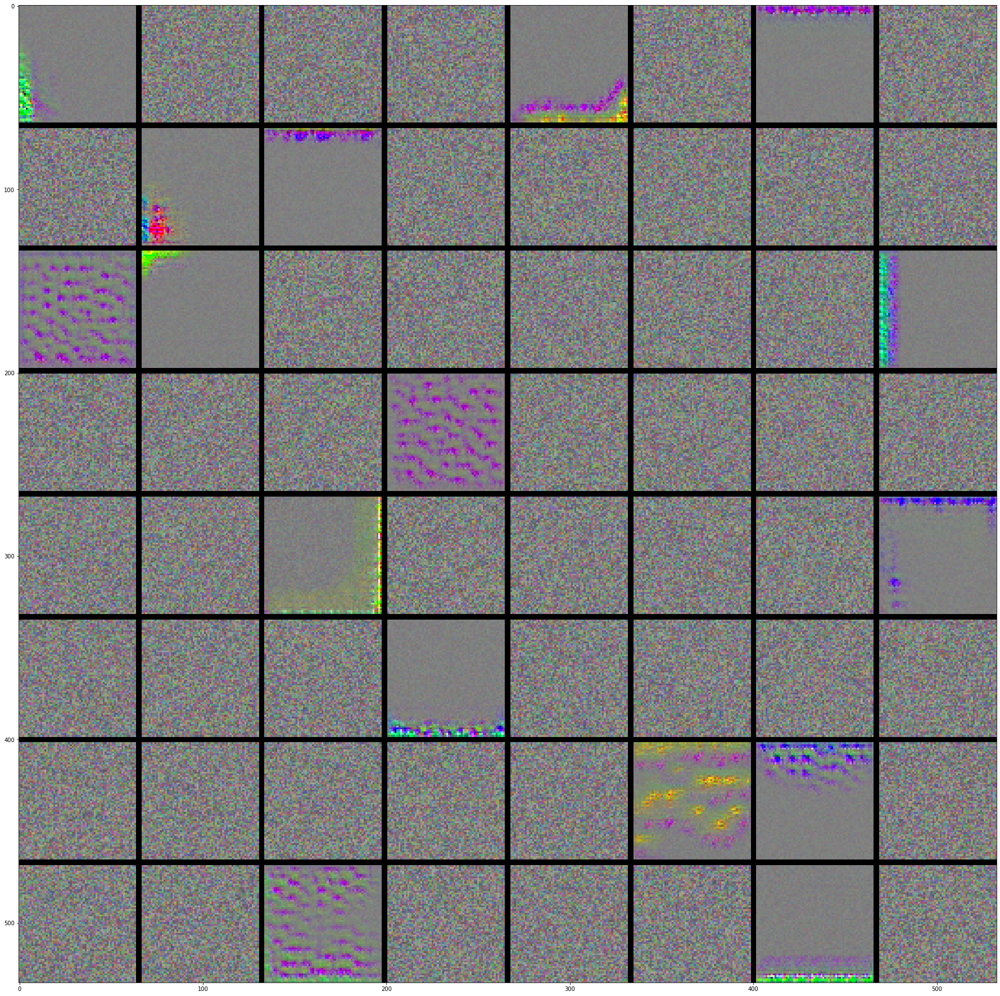

Layer name: conv2d_13


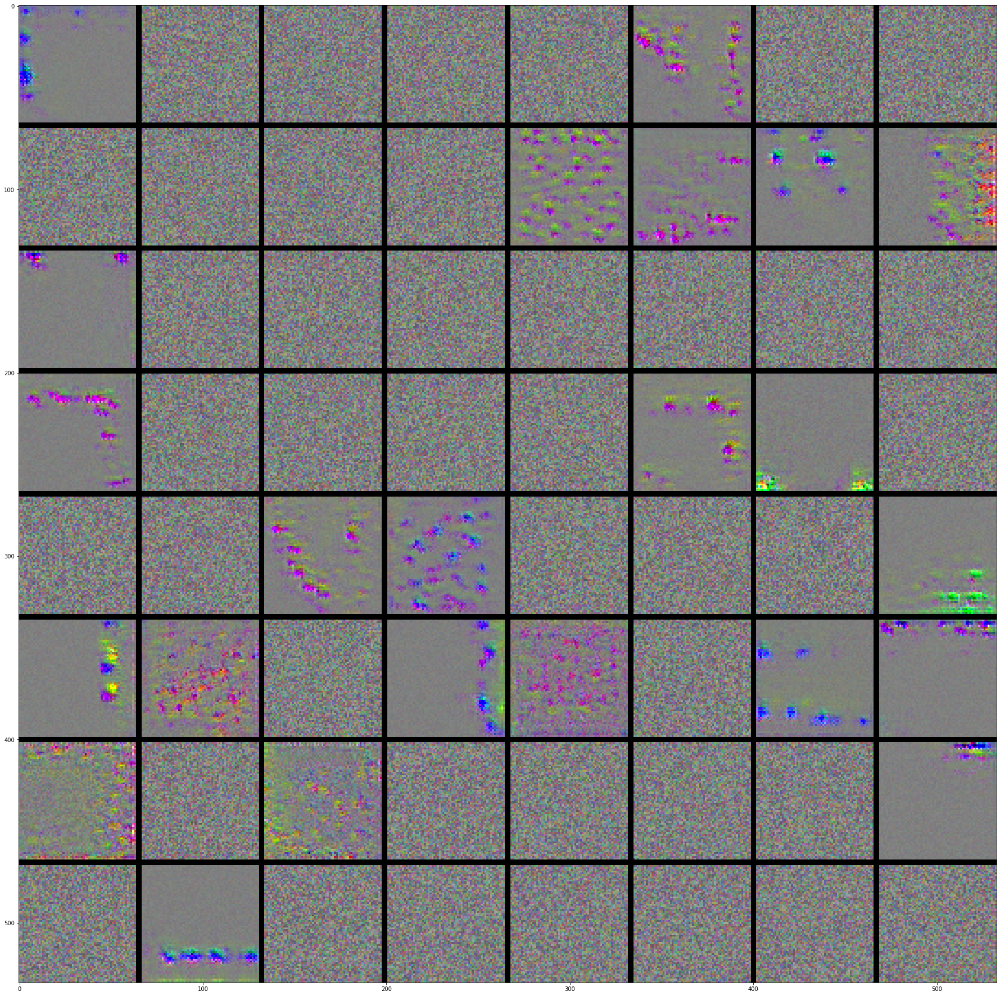

In [16]:
modelPlace = 4
print(str(modelPlace + 1) + ". Val_acc: " + str(round(resultList[modelPlace][2]['val_acc'][-1] * 100, 2)) + ": " + resultList[modelPlace][1])
for layer_name in resultList[modelPlace][7][1:]:
    results = np.zeros((no * size + 7 * margin, no * size + 7 * margin, 3), dtype=np.uint8)

    for i in range(no):
        for j in range(no):
            filter_img = generate_pattern(resultList[modelPlace][0], layer_name, i + (j * no), size=size)
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start : horizontal_end, vertical_start : vertical_end, : ] = filter_img
    print("Layer name: " + layer_name)
    plt.figure(figsize=(size / 2, size / 2))
    plt.imshow(results)
    plt.show()

## Wnioski z analizy
Przede wszystkim winę za średnią skuteczność sieci ponosi mały rozmiar datasetu, który koniecznie trzeba będzie w przyszłości rozbudować. Ze wszystkich sprawdzonych jednak modeli dochodzę do wniosku, że gdybym miał wybrać jeden z nich do użycia dla tego problemu, sieć na 4. miejscu pod kątem skuteczności dla zbioru byłaby moim wyborem. Największa ilość filtrów ma tam sens, aktywacje wyglądają na relatywnie sensowne, lecz być może istnieje zbyt duży overfitting do datasetu.